<a href="https://colab.research.google.com/github/irislqy/Sentiment-Analysis-GCP-AWS/blob/master/Sentimental_Analysis_NLP_GCP_and_AWS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**This notebook analyze a piece of Airbnb data in Boston area and conducts sentimental analysis of comments. **

BE AWARE OF: Data is small since tranlsation is costly in time and therefore the data might not be big enough to tell a concrete business story. 

Data:  https://www.kaggle.com/airbnb/boston

Goals: extract the sentiment of the comments and explore patterns

WordCloud

Tools used: 
    - Amazon Comprehend
    - Google Cloud Natural Language

## 1. Data Ingest

In [0]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
import pandas as pd


In [0]:
review = pd.read_csv("https://raw.githubusercontent.com/irislqy/NLP_gcp-aws/master/reviews.csv")

In [0]:
df = pd.read_csv("https://raw.githubusercontent.com/irislqy/NLP_gcp-aws/master/listings.csv")

In [0]:
df.head(3)

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,12147973,https://www.airbnb.com/rooms/12147973,20160906204935,2016-09-07,Sunny Bungalow in the City,"Cozy, sunny, family home. Master bedroom high...",The house has an open and cozy feel at the sam...,"Cozy, sunny, family home. Master bedroom high...",none,"Roslindale is quiet, convenient and friendly. ...",...,NaN,f,NaN,NaN,f,moderate,f,f,1,NaN
1,3075044,https://www.airbnb.com/rooms/3075044,20160906204935,2016-09-07,Charming room in pet friendly apt,Charming and quiet room in a second floor 1910...,Small but cozy and quite room with a full size...,Charming and quiet room in a second floor 1910...,none,"The room is in Roslindale, a diverse and prima...",...,9.0,f,NaN,NaN,t,moderate,f,f,1,1.30
2,6976,https://www.airbnb.com/rooms/6976,20160906204935,2016-09-07,Mexican Folk Art Haven in Boston,"Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...","Come stay with a friendly, middle-aged guy in ...",none,The LOCATION: Roslindale is a safe and diverse...,...,10.0,f,NaN,NaN,f,moderate,t,f,1,0.47


##2. Data Preparation

In [0]:
listings = df[['id','review_scores_rating','host_location','host_id','host_response_time']].copy()
listings.rename(index=str, columns={"id": "listing_id"},inplace = True)
listings.head()

,listing_id,review_scores_rating,host_location,host_id,host_response_time
0,12147973,NaN,"Boston, Massachusetts, United States",31303940,NaN
1,3075044,94.0,"Boston, Massachusetts, United States",2572247,within an hour
2,6976,98.0,"Boston, Massachusetts, United States",16701,within a few hours
3,1436513,100.0,"Boston, Massachusetts, United States",6031442,within a few hours
4,7651065,99.0,"Boston, Massachusetts, United States",15396970,within an hour


####Extract the First 300 records to do Comprehend.(Free Quota in AWS)

In [0]:
text = review[:2000]

In [0]:
text.head()

,listing_id,date,reviewer_name,comments
0,1178162,5/21/2013,Olivier,My stay at islam's place was really cool! Good...
1,1178162,5/29/2013,Charlotte,Great location for both airport and city - gre...
2,1178162,6/6/2013,Sebastian,We really enjoyed our stay at Islams house. Fr...
3,1178162,6/15/2013,Marine,The room was nice and clean and so were the co...
4,1178162,6/16/2013,Andrew,Great location. Just 5 mins walk from the Airp...


##3. AWS

In [0]:
!pip -q install boto3

In [0]:
import boto3

###3.1 Create API Config and Text Comprehend API call

In [0]:
!mkdir -p ~/.aws &&\
 cp /content/gdrive/My\ Drive/MachineLearning452/credentials.txt ~/.aws/credentials

In [0]:
import boto3
comprehend = boto3.client(service_name='comprehend', region_name="us-east-1")
text = "There is smoke in San Francisco"
comprehend.detect_sentiment(Text=text, LanguageCode='en')

{'ResponseMetadata': {'HTTPHeaders': {'connection': 'keep-alive',
   'content-length': '160',
   'content-type': 'application/x-amz-json-1.1',
   'date': 'Mon, 11 Mar 2019 22:08:22 GMT',
   'x-amzn-requestid': '2f87109c-444a-11e9-b128-8dc58a2619c7'},
  'HTTPStatusCode': 200,
  'RequestId': '2f87109c-444a-11e9-b128-8dc58a2619c7',
  'RetryAttempts': 0},
 'Sentiment': 'NEUTRAL',
 'SentimentScore': {'Mixed': 0.008628507144749165,
  'Negative': 0.1037612184882164,
  'Neutral': 0.8582549691200256,
  'Positive': 0.0293553676456213}}

### 3.2 Comprehend: Review

In [0]:
def create_sentiment(row):
    """Uses AWS Comprehend to Create Sentiments on a DataFrame"""

    try:
      comprehend = boto3.client(service_name='comprehend', region_name="us-east-1")
      payload = comprehend.detect_sentiment(Text=row, LanguageCode='en')  
      sentiment = payload['Sentiment']
    except Exception:
      print("Size exceeded:  Fail")
      return None
    return sentiment


In [0]:
import time
start = time.time()
##calculate the operation time in seconds

text['Sentiment'] = text['comments'].apply(create_sentiment)

end = time.time()
print("AWS 2000 reviews takes time in seconds: ", end-start)
text.head()

Size exceeded:  Fail
AWS 300 reviews takes time in seconds:  340.1163065433502


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


,listing_id,date,reviewer_name,comments,Sentiment
0,1178162,5/21/2013,Olivier,My stay at islam's place was really cool! Good...,POSITIVE
1,1178162,5/29/2013,Charlotte,Great location for both airport and city - gre...,POSITIVE
2,1178162,6/6/2013,Sebastian,We really enjoyed our stay at Islams house. Fr...,POSITIVE
3,1178162,6/15/2013,Marine,The room was nice and clean and so were the co...,POSITIVE
4,1178162,6/16/2013,Andrew,Great location. Just 5 mins walk from the Airp...,POSITIVE


### 3.3 Comprehend: EDA

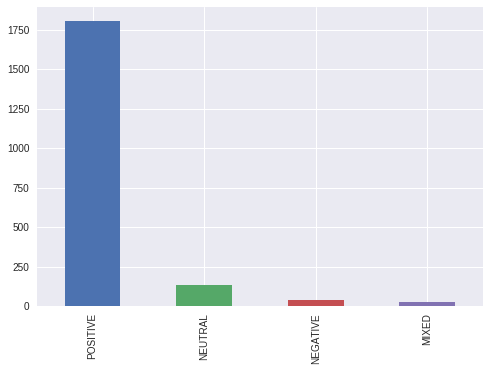

In [0]:
pd.value_counts(text['Sentiment']).plot.bar()

## most of the reviews are positive 
##Is it driven by behavior of rating high mutually to obtain a friendly personal profile? 
##Or is it because people don't give bad rating?


In [0]:
info_sentiment = pd.merge(text, listings, how='inner', on=['listing_id'])
info_sentiment.head()

,listing_id,date,reviewer_name,comments,Sentiment,review_scores_rating,host_location,host_id,host_response_time
0,1178162,5/21/2013,Olivier,My stay at islam's place was really cool! Good...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour
1,1178162,5/29/2013,Charlotte,Great location for both airport and city - gre...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour
2,1178162,6/6/2013,Sebastian,We really enjoyed our stay at Islams house. Fr...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour
3,1178162,6/15/2013,Marine,The room was nice and clean and so were the co...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour
4,1178162,6/16/2013,Andrew,Great location. Just 5 mins walk from the Airp...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour


In [0]:
import IPython
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot

def configure_plotly_browser_state():
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

configure_plotly_browser_state()
init_notebook_mode(connected=False)

#Separating churn and non churn customers
positive     = info_sentiment[info_sentiment["Sentiment"] == "POSITIVE"]
negative = info_sentiment[info_sentiment["Sentiment"] == "NEGATIVE"]

#function  for histogram for customer attrition types
def histogram(column) :
    trace1 = go.Histogram(x  = positive[column],
                          histnorm= "percent",
                          name = "POSITIVE",
                          marker = dict(line = dict(width = .5,
                                                    color = "black"
                                                    )
                                        ),
                         opacity = .9 
                         ) 
    
    trace2 = go.Histogram(x  = negative[column],
                          histnorm = "percent",
                          name = "NEGATIVE",
                          marker = dict(line = dict(width = .5,
                                              color = "black"
                                             )
                                 ),
                          opacity = .9
                         )
    
    data = [trace1,trace2]
    layout = go.Layout(dict(title =column + " distribution in sentiment ",
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = column,
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                            yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = "percent",
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                           )
                      )
    fig  = go.Figure(data=data,layout=layout)
    
    iplot(fig)

###3.3.1 Comprehend: EDA - Review Scores Rating Distribution

In [0]:
#remember to type these two lines of code in any cell to call plotly

configure_plotly_browser_state()
init_notebook_mode(connected=False)

histogram('review_scores_rating')

###not enough data for this chart. 
###histogram('column'): use this function to play whatever dimension you would love to explore

###3.3.2 Comprehend: EDA - Host Response Time Distribution in Sentiment

In [0]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)

histogram('host_response_time')

#Users can change the variable name above to explore the distribution for any variables in dataset.

###3.3.3 WordCloud (NLTK)

In [0]:
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
from nltk.probability import FreqDist
from wordcloud import WordCloud, STOPWORDS
from nltk.tokenize import word_tokenize 
import string
import matplotlib.pyplot as plt

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [0]:
def remove_punc_stopword(text):
    """
    Takes in a string of text, then performs the following:
    1. Remove all punctuation
    2. Remove all stopwords
    3. Returns a list of the cleaned text
    """
    remove_punc = [word for word in text if word not in string.punctuation]
    remove_punc = ''.join(remove_punc)
    return [word.lower() for word in remove_punc.split() if word.lower() not in stopwords.words('english')]

In [0]:
wc = text[['Sentiment','comments']].copy()
wc = wc.astype({'comments':'str'})
wc['comments'] = wc['comments'].apply(remove_punc_stopword)



In [0]:
wc.head()

,Sentiment,comments
0,POSITIVE,"[stay, islams, place, really, cool, good, loca..."
1,POSITIVE,"[great, location, airport, city, great, amenit..."
2,POSITIVE,"[really, enjoyed, stay, islams, house, outside..."
3,POSITIVE,"[room, nice, clean, commodities, close, airpor..."
4,POSITIVE,"[great, location, 5, mins, walk, airport, stat..."


In [0]:
wc_positive = wc[wc['Sentiment'] == 'POSITIVE']['comments'].values
wc_negative = wc[wc['Sentiment'] == 'NEGATIVE']['comments'].values

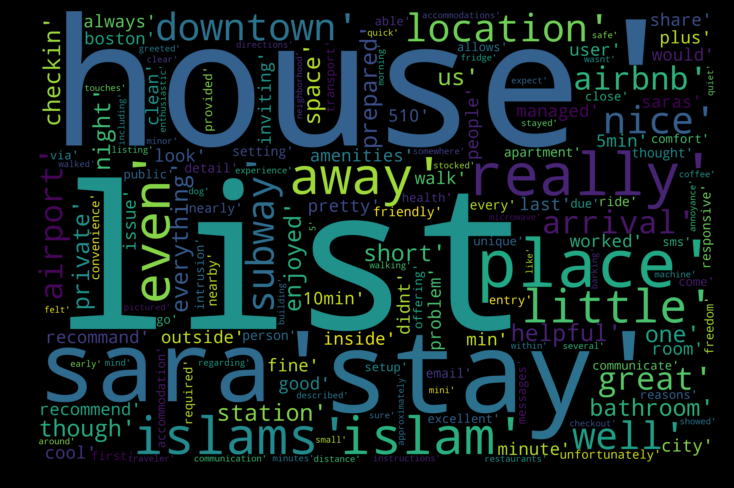

In [0]:
##Positive 
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(wc_positive))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)

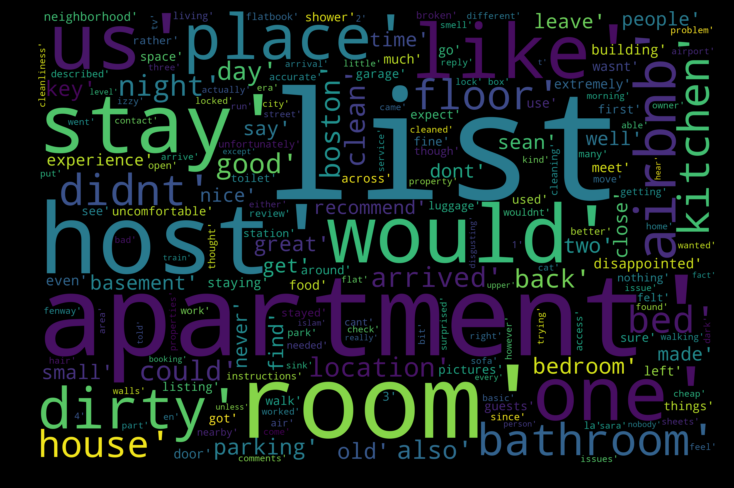

In [0]:
##Negative
wordcloud = WordCloud(
    width = 3000,
    height = 2000,
    background_color = 'black',
    stopwords = STOPWORDS).generate(str(wc_negative))

fig = plt.figure(
    figsize = (10, 7),
    facecolor = 'k',
    edgecolor = 'k')
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.tight_layout(pad=0)

##4. GCP

###4.1 Set up API

In [0]:
import os

# Imports the Google Cloud client library
from google.cloud import language
from google.cloud.language import enums
from google.cloud.language import types
from google.cloud import language_v1
from google.cloud.language_v1 import enums
import six



In [0]:
!export GOOGLE_APPLICATION_CREDENTIALS="/content/gdrive/My Drive/MachineLearning452/gcp_vision/credential_gcp.json"
!gcloud auth activate-service-account --key-file "/content/gdrive/My Drive/MachineLearning452/gcp_vision/credential_gcp.json"
os.environ["GOOGLE_APPLICATION_CREDENTIALS"]="/content/gdrive/My Drive/MachineLearning452/gcp_vision/credential_gcp.json"

Activated service account credentials for: [ml-gcp@silent-card-232805.iam.gserviceaccount.com]


###4.2 Entity Analysis

In [0]:
text = "LeBron James plays for the Cleveland Cavaliers."

client = language.LanguageServiceClient()
document = types.Document(
        content=text,
        type=enums.Document.Type.PLAIN_TEXT)
entities = client.analyze_entities(document).entities

entities

[name: "LeBron James"
type: PERSON
metadata {
  key: "mid"
  value: "/m/01jz6d"
}
metadata {
  key: "wikipedia_url"
  value: "https://en.wikipedia.org/wiki/LeBron_James"
}
salience: 0.8982541561126709
mentions {
  text {
    content: "LeBron James"
    begin_offset: -1
  }
  type: PROPER
}
, name: "Cleveland Cavaliers"
type: ORGANIZATION
metadata {
  key: "mid"
  value: "/m/0jm7n"
}
metadata {
  key: "wikipedia_url"
  value: "https://en.wikipedia.org/wiki/Cleveland_Cavaliers"
}
salience: 0.1017458513379097
mentions {
  text {
    content: "Cleveland Cavaliers"
    begin_offset: -1
  }
  type: PROPER
}
]

### 4.3 Text analysis: sentiment score

In [0]:
document = types.Document(
    content=text,
    type=enums.Document.Type.PLAIN_TEXT)

# Detects the sentiment of the text
sentiment = client.analyze_sentiment(document=document).document_sentiment

In [0]:
print("the score for text 'LeBron James plays for the Cleveland Cavaliers.' is ",sentiment.score) 

the score for text 'LeBron James plays for the Cleveland Cavaliers.' is  0.0


In [0]:
document = types.Document(
    content="weather is so Good!",
    type=enums.Document.Type.PLAIN_TEXT)

# Detects the sentiment of the text
sentiment = client.analyze_sentiment(document=document).document_sentiment

In [0]:
print("weather is so Good!' is ",sentiment.score) 

weather is so Good!' is  0.8999999761581421


In [0]:
info_sentiment.head()

,listing_id,date,reviewer_name,comments,Sentiment,review_scores_rating,host_location,host_id,host_response_time
0,1178162,5/21/2013,Olivier,My stay at islam's place was really cool! Good...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour
1,1178162,5/29/2013,Charlotte,Great location for both airport and city - gre...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour
2,1178162,6/6/2013,Sebastian,We really enjoyed our stay at Islams house. Fr...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour
3,1178162,6/15/2013,Marine,The room was nice and clean and so were the co...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour
4,1178162,6/16/2013,Andrew,Great location. Just 5 mins walk from the Airp...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour


###4.4 Translation



Exceed Limited Quota 

In [0]:
!pip install --upgrade google-cloud-translate
from google.cloud import translate

def translate_english(text):
  """Translates text into the target language"""
  translate_client = translate.Client()

  if isinstance(text, six.binary_type):
    text = text.decode('utf-8')

    # Text can also be a sequence of strings, in which case this method
    # will return a sequence of results for each text.
  result = translate_client.translate(
        text, target_language="en")
  return result['translatedText']

info_sentiment['translated_comments'] = info_sentiment['comments'].apply(translate_english)

Translate into English

In [0]:
import boto3

translate = boto3.client('translate',region_name = "us-east-1")

In [0]:
def translation_english(comments):
  fail_num = 0
  try:
    response = translate.translate_text(Text=comments,SourceLanguageCode="auto",TargetLanguageCode='en')
    return response["TranslatedText"]
  except Exception:
    fail_num = fail_num + 1 
    return None
  print(fail_num)
    

In [0]:
info_sentiment['translated_comments'] = info_sentiment['comments'].apply(translation_english)

In [0]:
info_sentiment = info_sentiment.astype({'translated_comments':'str'})

### 4.5 Sentiment Analysis: Airbnb Data

In [0]:
edef gcp_analyze_sentiment(content):

    client = language_v1.LanguageServiceClient()

    if isinstance(content, six.binary_type):
        content = content.decode('utf-8')

    type_ = enums.Document.Type.PLAIN_TEXT
    document = {'type': type_, 'content': content}

    response = client.analyze_sentiment(document)
    sentiment = response.document_sentiment.score

    return(sentiment)

In [0]:
import time
start = time.time()

info_sentiment['Sentiment Score'] = info_sentiment['translated_comments'].apply(lambda x: gcp_analyze_sentiment(x))

end = time.time()
print("GCP Sentiment Analsis takes time in seconds", start-end)

GCP Sentiment Analsis takes time in seconds -346.3061423301697


In [0]:
info_sentiment.head()

,listing_id,date,reviewer_name,comments,Sentiment,review_scores_rating,host_location,host_id,host_response_time,sentiment_score,translated_comments,Sentiment Score
0,1178162,5/21/2013,Olivier,My stay at islam's place was really cool! Good...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour,NaN,My stay at islam's place was really cool! Good...,0.8
1,1178162,5/29/2013,Charlotte,Great location for both airport and city - gre...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour,NaN,Great location for both airport and city - gre...,0.9
2,1178162,6/6/2013,Sebastian,We really enjoyed our stay at Islams house. Fr...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour,NaN,We really enjoyed our stay at Islams house. Fr...,0.4
3,1178162,6/15/2013,Marine,The room was nice and clean and so were the co...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour,0.8,The room was nice and clean and so were the co...,0.8
4,1178162,6/16/2013,Andrew,Great location. Just 5 mins walk from the Airp...,POSITIVE,86.0,"Boston, Massachusetts, United States",1407005,within an hour,NaN,Great location. Just 5 mins walk from the Airp...,0.6


##5. Benchmarking: AWS and GCP Sentiment Analysis Result cComparison

In [0]:
import IPython
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot

def configure_plotly_browser_state():
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

configure_plotly_browser_state()
init_notebook_mode(connected=False)

#Separating churn and non churn customers
positive     = info_sentiment[info_sentiment["Sentiment"] == "POSITIVE"]
negative = info_sentiment[info_sentiment["Sentiment"] == "NEGATIVE"]

#function  for histogram for customer attrition types
def histogram(column) :
    trace1 = go.Histogram(x  = positive[column],
                          histnorm= "percent",
                          name = "POSITIVE",
                          marker = dict(line = dict(width = .5,
                                                    color = "black"
                                                    )
                                        ),
                         opacity = .9 
                         ) 
    
    trace2 = go.Histogram(x  = negative[column],
                          histnorm = "percent",
                          name = "NEGATIVE",
                          marker = dict(line = dict(width = .5,
                                              color = "black"
                                             )
                                 ),
                          opacity = .9
                         )
    
    data = [trace1,trace2]
    layout = go.Layout(dict(title =column + " distribution across sentiment type predicted by AWS",
                            plot_bgcolor  = "rgb(243,243,243)",
                            paper_bgcolor = "rgb(243,243,243)",
                            xaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = column,
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                            yaxis = dict(gridcolor = 'rgb(255, 255, 255)',
                                             title = "percent",
                                             zerolinewidth=1,
                                             ticklen=5,
                                             gridwidth=2
                                            ),
                           )
                      )
    fig  = go.Figure(data=data,layout=layout)
    
    iplot(fig)

In [0]:
configure_plotly_browser_state()
init_notebook_mode(connected=False)
histogram("Sentiment Score")

##6. Conclusion

**Conclusion:**

**This notebook explores different NLP analysis:**

1.   Entity analysis (GCP)
2.   Sentiment Analys (AWS: POSITIVE & NEGATIVE; GCP: Sentiment Score)
3.   Language Translate (AWS, GCP)

**Take-away**

1. AWS gives more free quota (I think, also more applicable)

2. Sentiment analysis is costly in time and ram. 2k reviews, aws takes 340 seconds and GCP takes 346 seconds.








  